# Image Processing: Lung X-Rays

## Problem Statement

Can we predict whether a person has Covid-19 or not by using lung X-Ray images?

Covid-19 is an illness caused by a virus that can spread from person to person either through direct contact, airborne droplets, or infected surfaces. This virus has affected many world-wide and spread rapidly. As of June 9th, 2020, There were over 7 million known cases in the world. There is currently no vaccine. People are encouraged to wash their hands, disinfect regularly, not come into close contact to others, not touch their faces, and stay home as much as possible. With limited testing availability, many are looking for alternative ways of identifying the virus. However, these methodologies do not currently replace molecular laboratory tests to diagnose Covid-19 as symptoms range from no or minor symptoms to sever symptoms.

## Executive Summary

Image processing of 5,887 images show us a starting point for identifying Covid-19. Because of the small sample size of Covid-19 images, X-rays of patients with pneumonia are also being processed since they show similar opacities as those in X-rays of Covid-19 patients. In the results, we can see that there were more misclassification of healthy patients. Labeling patients that are healthy as unhealthy I believe is a better outcome than labeling patients that are unhealthy as healthy. Patients can self-isolate and take the precautions necessary to not infect others until they can confirm if they have Covid-19 with the formal molecular lab tests.

# Contents

- [Imports](#Imports)
- [Loading Data](#Loading-Data)
- [Image Processing](#Image-Processing)
- [Model](#Model)
- [Conclusion](#Conclusion)
- [Fine Tuning the Model](#Fine-Tuning-the-Model)
- [Function with Frozen Layers](#Function-with-Frozen-Layers)
- [Takeaways](#Takeaways)


# Imports

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import pathlib
from sklearn.model_selection import train_test_split
import IPython.display as display
from PIL import Image
import glob
import os
import random
import shutil
from shutil import copytree

In [109]:
import pandas as pd

In [2]:
AUTOTUNE = tf.data.experimental.AUTOTUNE

# Loading Data

Images were downloaded from Roboflow and were separated into "Healthy", "Pneumonia", and "Covid-19" folders. I created additional folders to split the data into a training, validation, and testing set. Tensorflow was then used to load the values

In [3]:
# Classes available for X-Rays
class_names = np.array(['healthy', 'pneumonia', 'covid'])
class_names

batch_size = 32

In [4]:
data_dir = pathlib.Path('./images/train/')

# Check number of images in each category
healthy= list(data_dir.glob('*healthy/*.jpg'))
pneumonia = list(data_dir.glob('*pneumonia/*.jpg'))
covid = list(data_dir.glob('*covid/*.jpg'))

In [5]:
print(f'healthy lungs: {len(healthy)} images')
print(f'pneumonia lungs: {len(pneumonia)} images')
print(f'coivd lungs: {len(covid)} images')

healthy lungs: 1965 images
pneumonia lungs: 3723 images
coivd lungs: 199 images


In [6]:
# The sum of the different categories matches the total number of images
len(healthy) + len(pneumonia) + len(covid)

5887

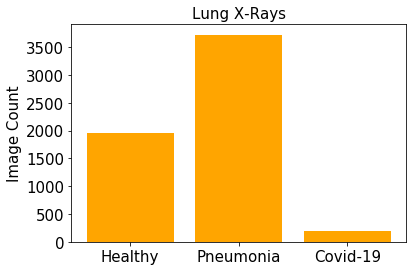

In [89]:
# plot number of images for each category
plt.bar(['Healthy', 'Pneumonia', 'Covid-19'], [1965, 3723, 199], color = 'orange')
plt.ylabel("Image Count", fontsize= 15)
plt.title("Lung X-Rays", fontsize=15)
plt.xticks(fontsize= 15)
plt.yticks(fontsize= 15);

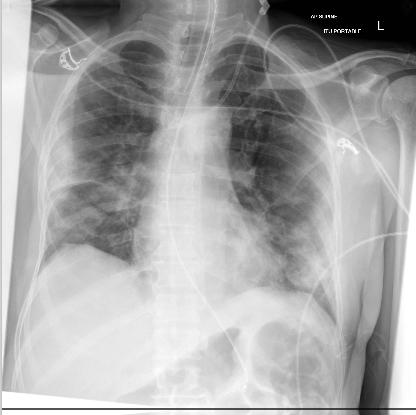

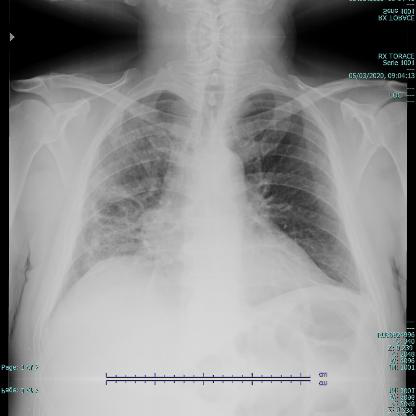

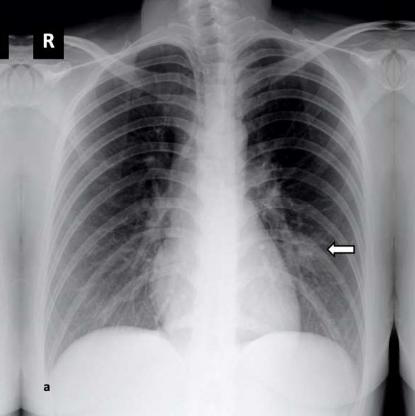

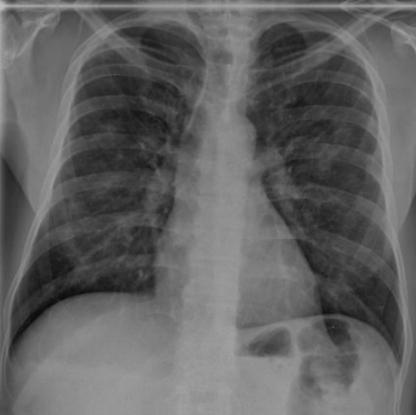

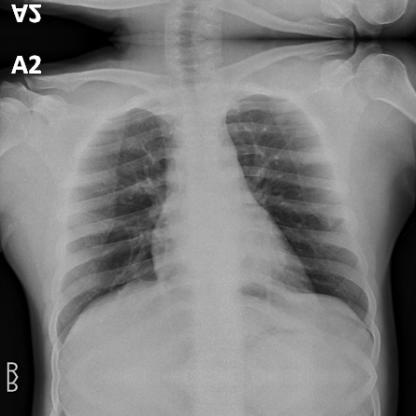

...

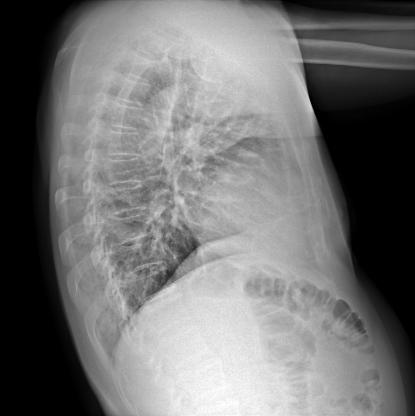

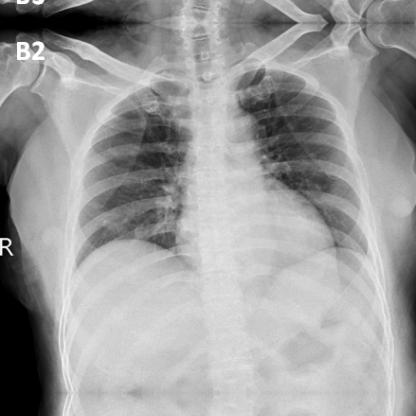

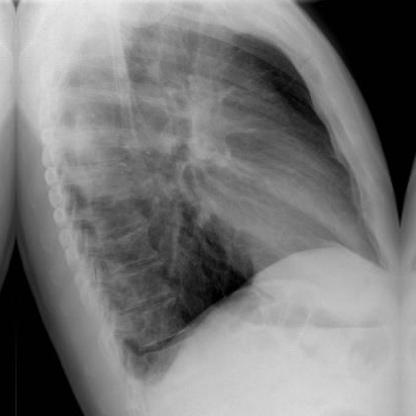

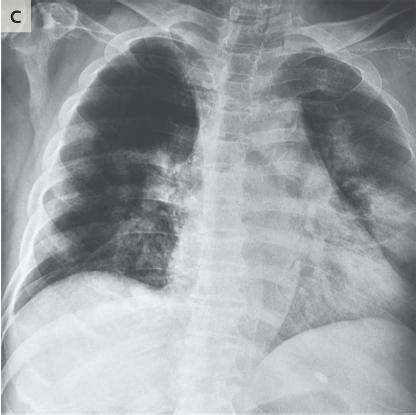

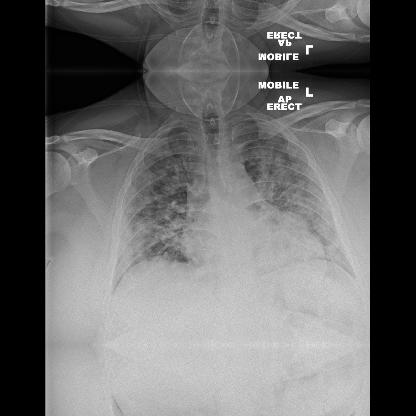

In [12]:
# Used this code to skim through the imags
for image_path in list(data_dir_train.glob('*covid/*')):
    display.display(Image.open(str(image_path)))

In [7]:
# Function to move files from train folder to test/val folder

def move_files(list, folder):
    for i in list:
        shutil.move(str(i), f'images/{folder}', copy_function=shutil.copy2)
    return 'Complete' 

In [8]:
# creating test subset
healthy_test = random.sample(healthy, int(len(healthy)*.1))
pneumonia_test = random.sample(pneumonia, int(len(pneumonia)*.1))
covid_test = random.sample(covid, int(len(covid)*.1))

move_files(healthy_test, 'test/healthy')
move_files(pneumonia_test, folder = 'test/pneumonia')
move_files(covid_test, folder = 'test/covid')

'Complete'

In [9]:
# updating list of train images
data_dir = pathlib.Path('./images/train/')

healthy = list(data_dir.glob('*healthy/*.jpg'))
pneumonia = list(data_dir.glob('*pneumonia/*.jpg'))
covid = list(data_dir.glob('*covid/*.jpg'))

In [10]:
# creating val subset
healthy_val = random.sample(healthy, len(healthy_test))
pneumonia_val = random.sample(pneumonia, len(pneumonia_test))
covid_val = random.sample(covid, len(covid_test))

move_files(healthy_val, 'validation/healthy')
move_files(pneumonia_val, 'validation/pneumonia')
move_files(covid_val, 'validation/covid')

'Complete'

In [11]:
# train, val, test
data_dir_train = pathlib.Path('./images/train/')
data_dir_val = pathlib.Path('./images/validation/')
data_dir_test = pathlib.Path('./images/test/')

list_train = tf.data.Dataset.list_files(str(data_dir_train/'*/*'))
list_val = tf.data.Dataset.list_files(str(data_dir_val/'*/*'))
list_test = tf.data.Dataset.list_files(str(data_dir_test/'*/*'))

In [13]:
# Checking sum of all images after split into train, validation, and test matches
h = len(list(data_dir_train.glob('*healthy/*.jpg'))) + len(list(data_dir_train.glob('*pneumonia/*.jpg')))  + len(list(data_dir_train.glob('*covid/*.jpg')))
v = len(list(data_dir_val.glob('*healthy/*.jpg'))) + len(list(data_dir_val.glob('*pneumonia/*.jpg')))  + len(list(data_dir_val.glob('*covid/*.jpg')))
t = len(list(data_dir_test.glob('*healthy/*.jpg'))) + len(list(data_dir_test.glob('*pneumonia/*.jpg')))  + len(list(data_dir_test.glob('*covid/*.jpg')))

print(f'train dataset: {h} images')
print(f'validation dataset: {v} images')
print(f'test dataset: {t} images')

train dataset: 4713 images
validation dataset: 587 images
test dataset: 587 images


In [14]:
# Sum matches total
h+v+t

5887

In [15]:
# checking lists for train, val, and test
for f in list_train.take(2):
  print(f.numpy())

for f in list_val.take(2):
  print(f.numpy())

for f in list_test.take(2):
  print(f.numpy())

b'images/train/pneumonia/55be1b81-efdb-4197-91bb-6e2b02a2f3b8_jpg.rf.30693148083610801117d585c1a4f23d.jpg'
b'images/train/pneumonia/e605f5f5-ac7b-4aab-981e-ebee0af815cc_jpg.rf.bdaa7a8c5b6a0ad1d65fcb471a11c50e.jpg'
b'images/validation/pneumonia/4a8305c3-35cb-4306-8a79-c08de742dd23_jpg.rf.31de6dd83f08a73d853087db7b59a4b5.jpg'
b'images/validation/pneumonia/c7d977ec-9f80-440f-9b72-ec052152742d_jpg.rf.3f47c0c1f1ec3b04222772527d5308f0.jpg'
b'images/test/healthy/b15bc724-ed99-47a1-b59c-ccd26a41d372_jpg.rf.23adfe45e051e357c04849834e219f5d.jpg'
b'images/test/covid/covid-19-pneumonia-43-day2_jpeg.rf.a00b49479198d01af77a13e76cabbe3e.jpg'


# Image Processing

In [ ]:
# Followed Tensorflow training

In [16]:
def get_label(file_path):
  # convert the path to a list of path components
  parts = tf.strings.split(file_path, os.path.sep)
  # The second to last is the class-directory
  return parts[-2] == class_names

In [22]:
def decode_img(img):
    # convert the compressed string to a 3D uint8 tensor
    img = tf.image.decode_jpeg(img, channels=3)
    # Use `convert_image_dtype` to convert to floats in the [0,1] range.
    # img = (img/127.5) - 1   
    img = tf.image.convert_image_dtype(img, tf.float32)
    # resize the image to the desired size.
    return tf.image.resize(img, [IMG_WIDTH, IMG_HEIGHT])

In [23]:
def process_path(file_path):
    label = get_label(file_path)
    # load the raw data from the file as a string
    img = tf.io.read_file(file_path)
    img = decode_img(img)
    return img, label

In [24]:
# Set `num_parallel_calls` so multiple images are loaded/processed in parallel.

IMG_WIDTH = 160
IMG_HEIGHT = 160

labeled_train = list_train.map(process_path, num_parallel_calls=AUTOTUNE)
labeled_test = list_test.map(process_path, num_parallel_calls=AUTOTUNE)
labeled_val = list_val.map(process_path, num_parallel_calls=AUTOTUNE)

In [25]:
for image, label in labeled_train.take(1):
  print("Image shape: ", image.numpy().shape)
  print("Label: ", label.numpy())

Image shape:  (160, 160, 3)
Label:  [False  True False]


In [78]:
def process_path2(file_path):
    label = get_label(file_path)
    # load the raw data from the file as a string
    img = tf.io.read_file(file_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)
    return img, label

In [79]:
for image, label in list_train.map(process_path2, num_parallel_calls=AUTOTUNE).take(1):
  print("Image shape: ", image.numpy().shape)
  print("Label: ", label.numpy())

Image shape:  (416, 416, 3)
Label:  [False  True False]


In [26]:
for image_test, label_test in labeled_test.take(1):
  print("Image shape: ", image_test.numpy().shape)
  print("Label: ", label_test.numpy())

Image shape:  (160, 160, 3)
Label:  [False  True False]


In [27]:
for image_val, label_val in labeled_val.take(1):
  print("Image shape: ", image_val.numpy().shape)
  print("Label: ", label_val.numpy())

Image shape:  (160, 160, 3)
Label:  [False  True False]


In [28]:
def prepare_for_training(ds, cache=True, shuffle_buffer_size=1000):

  if cache:
    if isinstance(cache, str):
      ds = ds.cache(cache)
    else:
      ds = ds.cache()

  ds = ds.shuffle(buffer_size=shuffle_buffer_size)

  # Repeat forever
  ds = ds.repeat()

  ds = ds.batch(batch_size)

  # `prefetch` lets the dataset fetch batches in the background while the model
  # is training.
  ds = ds.prefetch(buffer_size=AUTOTUNE)

  return ds

In [29]:
train_ds = prepare_for_training(labeled_train)
image_batch_train, label_batch_train = next(iter(train_ds))

val_ds = prepare_for_training(labeled_val)
image_batch_val, label_batch_val = next(iter(val_ds))

test_ds = prepare_for_training(labeled_test)
image_batch_test, label_batch_test = next(iter(test_ds))

In [30]:
def show_batch(image_batch, label_batch):
  plt.figure(figsize=(10,10))
  for n in range(25):
      ax = plt.subplot(5,5,n+1)
      plt.imshow(image_batch[n])
      plt.title(class_names[label_batch[n]==1][0].title())
      plt.axis('off')

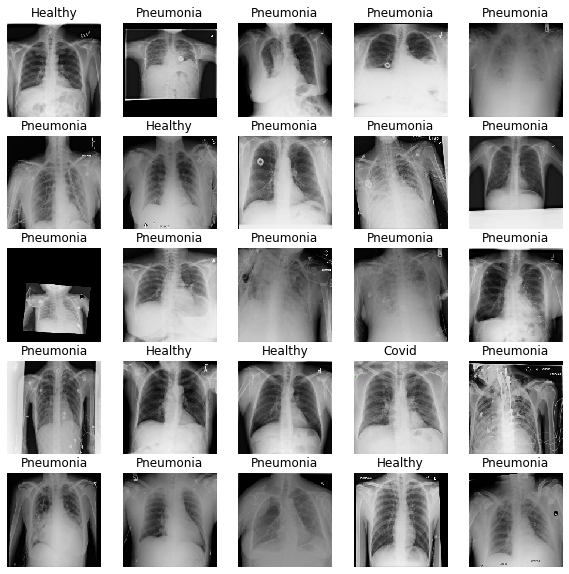

In [31]:
show_batch(image_batch_train.numpy(), label_batch_train.numpy())

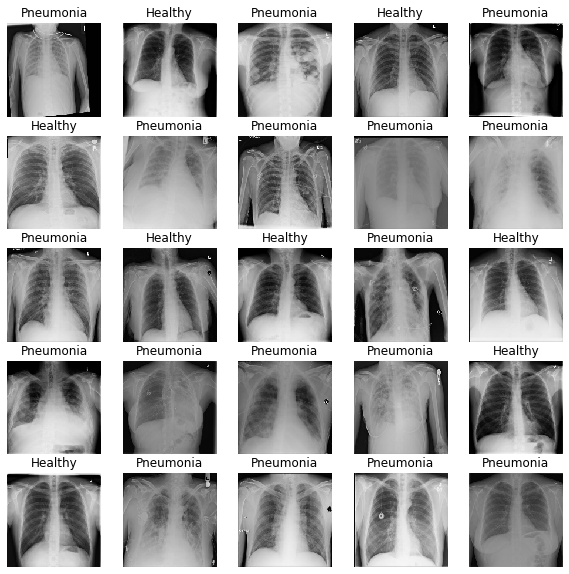

In [32]:
show_batch(image_batch_val.numpy(), label_batch_val.numpy())

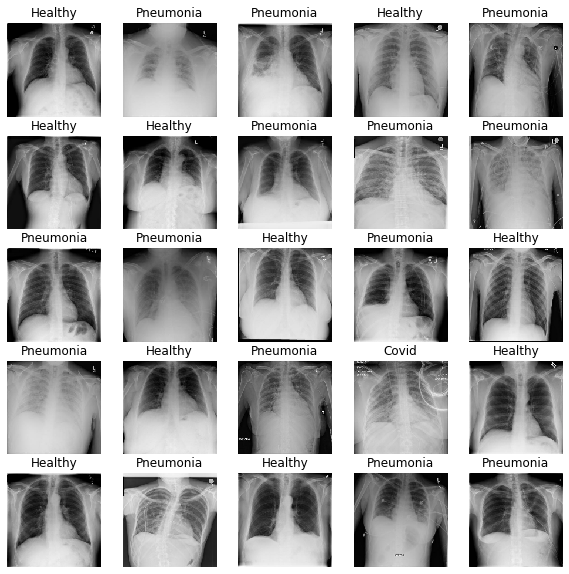

In [33]:
show_batch(image_batch_test.numpy(), label_batch_test.numpy())

In [34]:
for image_batch, label_batch in train_ds.take(1):
   pass

image_batch.shape

TensorShape([32, 160, 160, 3])

# Model

In [36]:
IMG_SHAPE = (IMG_WIDTH, IMG_HEIGHT, 3)

# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                               include_top=False,
                                               weights='imagenet')

In [37]:
# Feature Extraction
# Freeze the convolutional base
base_model.trainable = False

In [38]:
base_model.summary()

Model: "mobilenetv2_1.00_160"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 160, 160, 3) 0                                            
__________________________________________________________________________________________________
Conv1_pad (ZeroPadding2D)       (None, 161, 161, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 80, 80, 32)   864         Conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 80, 80, 32)   128         Conv1[0][0]                      
_______________________________________________________________________________

In [39]:
feature_batch = base_model(image_batch)
print(feature_batch.shape)

(32, 5, 5, 1280)


In [40]:
# Classification head
global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 1280)


In [41]:
# single prediction per image 
prediction_layer = tf.keras.layers.Dense(3)
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 3)


In [42]:
model = tf.keras.Sequential([
  base_model,
  global_average_layer,
  prediction_layer
])

In [43]:
base_learning_rate = 0.0001
model.compile(optimizer=tf.keras.optimizers.Adam(lr=base_learning_rate),
              loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [44]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_160 (Model) (None, 5, 5, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 3)                 3843      
Total params: 2,261,827
Trainable params: 3,843
Non-trainable params: 2,257,984
_________________________________________________________________


In [45]:
len(model.trainable_variables)

2

In [46]:
initial_epochs = 10
validation_steps = 20

loss0,accuracy0 = model.evaluate(val_ds, steps = validation_steps)

20/20 [==============================] - 12s 589ms/step - loss: 1.4686 - accuracy: 0.2500


In [47]:
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

initial loss: 1.47
initial accuracy: 0.25


In [48]:
image_count = len(list(data_dir_train.glob('*/*.jpg')))
image_count_v = len(list(data_dir_val.glob('*/*.jpg')))

In [49]:
step = np.ceil(image_count/batch_size)
v_step = np.ceil(image_count_v/batch_size)

history_tf = model.fit(train_ds,
                       epochs=initial_epochs,
                       steps_per_epoch = step,
                       validation_data=val_ds,
                       validation_steps = v_step)

Epoch 1/10
148/148 [==============================] - 111s 747ms/step - loss: 0.8450 - accuracy: 0.5762 - val_loss: 0.6448 - val_accuracy: 0.7270
Epoch 2/10
148/148 [==============================] - 101s 683ms/step - loss: 0.6073 - accuracy: 0.7331 - val_loss: 0.5575 - val_accuracy: 0.7763
Epoch 3/10
148/148 [==============================] - 103s 694ms/step - loss: 0.5540 - accuracy: 0.7639 - val_loss: 0.5248 - val_accuracy: 0.7845
Epoch 4/10
148/148 [==============================] - 102s 689ms/step - loss: 0.5209 - accuracy: 0.7772 - val_loss: 0.4972 - val_accuracy: 0.7944
Epoch 5/10
148/148 [==============================] - 102s 690ms/step - loss: 0.4988 - accuracy: 0.7874 - val_loss: 0.4827 - val_accuracy: 0.8026
Epoch 6/10
148/148 [==============================] - 100s 678ms/step - loss: 0.4858 - accuracy: 0.7922 - val_loss: 0.4712 - val_accuracy: 0.8109
Epoch 7/10
148/148 [==============================] - 101s 685ms/step - loss: 0.4702 - accuracy: 0.8011 - val_loss: 0.4559 -

# Results

Keeping all layers frozen, the validation accuracy score is 82%. Next I will look at the result of running the test data.

In [50]:
model.save('model')

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: model/assets


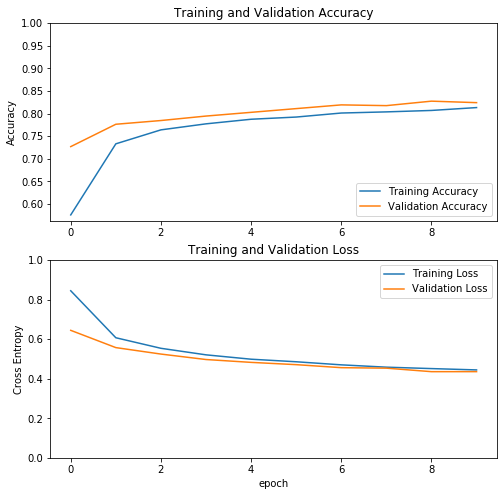

In [53]:
acc = history_tf.history['accuracy']
val_acc = history_tf.history['val_accuracy']

loss = history_tf.history['loss']
val_loss = history_tf.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [164]:
image_generator = tf.keras.preprocessing.image.ImageDataGenerator(rescale=1./255)

In [243]:
val_data_gen = image_generator.flow_from_directory(batch_size=32,
                                                 directory=data_dir_test,
                                                 target_size=(224, 224),
                                                 class_mode='categorical')

Found 587 images belonging to 3 classes.


In [253]:
y_pred = []
batch_labels_list = []
for i in range(19):
    batch_images, batch_labels = next(val_data_gen)
    y_pred = y_pred + model.predict(batch_images).tolist()
    batch_labels_list = batch_labels_list + batch_labels.tolist()
#     batch_labels_list.append(batch_labels)
    
len(y_pred)

587

In [258]:
covid_count_aa = 0
for i in range(0, len(y_pred)):
    if(np.argmax(batch_labels_list[i]) == 0):
        covid_count_aa+=1

print(covid_count_aa)

19


In [277]:
for i in range(0, len(batch_labels_list)):
    tmp = batch_labels_list[i][0]
    batch_labels_list[i][0] = batch_labels_list[i][1]
    batch_labels_list[i][1] = tmp

In [278]:
pred = np.argmax(y_pred, axis = -1)
pred

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 2, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1,
       1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 0, 2, 1, 0, 1, 1,
       1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 0,
       1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       0, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 1, 0, 2, 1, 0, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1,
       2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1,
       0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1,

In [279]:
y_pred_list = []

for i in pred:
    if i == 0:
        y_pred_list.append('healthy')
    if i == 1:
        y_pred_list.append('pneumonia')
    if i == 2:
        y_pred_list.append('covid')
        
y_pred_list

['pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'healthy',
 'pneumonia',
 'pneumonia',
 'covid',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'healthy',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'healthy',
 'pneumonia',
 '

In [280]:
y = np.argmax(batch_labels_list, axis = -1)
y

array([1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1,
       1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1,
       1, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 2, 1, 1,
       1, 1, 1, 1, 1, 2, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 0, 2, 0, 0, 1, 1,
       1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 2, 1, 1, 1, 1, 0, 1, 1, 0,
       1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1,
       0, 0, 1, 1, 1, 1, 1, 0, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0, 0, 2, 0, 1, 0, 1,
       2, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0,
       1, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1,
       0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 2, 1, 1, 1,
       1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1,

In [281]:
y_list = []

for i in y:
    if i == 0:
        y_list.append('healthy')
    if i == 1:
        y_list.append('pneumonia')
    if i == 2:
        y_list.append('covid')
        
y_list

['pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'healthy',
 'pneumonia',
 'healthy',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'healthy',
 'pneumonia',
 'pneumonia',
 'healthy',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'healthy',
 'healthy',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'healthy',
 'pneumonia',
 'pneumonia',
 'healthy',
 'pneumonia',
 'healthy',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'healthy',
 'healthy',
 'healthy',
 'pneumonia',
 'healthy',
 'healthy',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'healthy',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'healthy',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'pneumonia',
 'healthy',
 'healthy',
 'healthy',
 'pneumonia',
 'healthy',
 'healthy',
 'pneu

In [282]:
results = pd.DataFrame(y_list,
                   columns=['y'])
results

,y
0,pneumonia
1,pneumonia
2,pneumonia
3,pneumonia
4,healthy
...,...
582,pneumonia
583,healthy
584,healthy
585,pneumonia


In [283]:
results['pred'] = y_pred_list

In [284]:
results

,y,pred
0,pneumonia,pneumonia
1,pneumonia,pneumonia
2,pneumonia,pneumonia
3,pneumonia,pneumonia
4,healthy,pneumonia
...,...,...
582,pneumonia,pneumonia
583,healthy,pneumonia
584,healthy,pneumonia
585,pneumonia,pneumonia


In [285]:
results['pred'].value_counts(normalize = True)

pneumonia    0.870528
healthy      0.090290
covid        0.039182
Name: pred, dtype: float64

In [286]:
results['y'].value_counts(normalize = True)

pneumonia    0.649063
healthy      0.318569
covid        0.032368
Name: y, dtype: float64

In [287]:
results['y'].value_counts()

pneumonia    381
healthy      187
covid         19
Name: y, dtype: int64

In [288]:
results[results['y'] == 'healthy']['pred'].value_counts(normalize = True)

pneumonia    0.754011
healthy      0.229947
covid        0.016043
Name: pred, dtype: float64

In [289]:
results[results['y'] == 'pneumonia']['pred'].value_counts(normalize = True)

pneumonia    0.963255
healthy      0.026247
covid        0.010499
Name: pred, dtype: float64

In [290]:
results[results['y'] == 'covid']['pred'].value_counts(normalize = True)

covid        0.842105
pneumonia    0.157895
Name: pred, dtype: float64

In [291]:
results[results['y'] == 'healthy']['pred'].value_counts()

pneumonia    141
healthy       43
covid          3
Name: pred, dtype: int64

In [292]:
results[results['y'] == 'pneumonia']['pred'].value_counts()

pneumonia    367
healthy       10
covid          4
Name: pred, dtype: int64

In [293]:
results[results['y'] == 'covid']['pred'].value_counts()

covid        16
pneumonia     3
Name: pred, dtype: int64

In [294]:
(43+367+16)/(14+3+140+45+2+338+10+3)

0.7675675675675676

In [234]:
(14+3+140+45+2+338+10+3)

555

In [295]:
from sklearn.metrics import classification_report

In [297]:
results['y'].value_counts()

pneumonia    381
healthy      187
covid         19
Name: y, dtype: int64

In [300]:
print(classification_report(results["y"], results['pred']))

              precision    recall  f1-score   support

       covid       0.70      0.84      0.76        19
     healthy       0.81      0.23      0.36       187
   pneumonia       0.72      0.96      0.82       381

    accuracy                           0.73       587
   macro avg       0.74      0.68      0.65       587
weighted avg       0.75      0.73      0.67       587



# Fine Tuning the Model

In [54]:
base_model.trainable = True

In [55]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 100

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

Number of layers in the base model:  155


In [56]:
model.compile(loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
              optimizer = tf.keras.optimizers.Adam(lr=base_learning_rate/10),
              metrics=['accuracy'])

In [57]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
mobilenetv2_1.00_160 (Model) (None, 5, 5, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d (Gl (None, 1280)              0         
_________________________________________________________________
dense (Dense)                (None, 3)                 3843      
Total params: 2,261,827
Trainable params: 1,866,435
Non-trainable params: 395,392
_________________________________________________________________


In [58]:
len(model.trainable_variables)

58

In [59]:
fine_tune_epochs = 10
total_epochs =  initial_epochs + fine_tune_epochs

history_fine_tf = model.fit(train_ds,
                            epochs=total_epochs,
                            steps_per_epoch = step,
                            initial_epoch =  history_tf.epoch[-1],
                            validation_data=val_ds,
                            validation_steps = v_step)

Epoch 10/20
148/148 [==============================] - 188s 1s/step - loss: 0.9129 - accuracy: 0.6001 - val_loss: 0.6171 - val_accuracy: 0.7599
Epoch 11/20
148/148 [==============================] - 162s 1s/step - loss: 0.4806 - accuracy: 0.8102 - val_loss: 0.5337 - val_accuracy: 0.8043
Epoch 12/20
148/148 [==============================] - 166s 1s/step - loss: 0.4091 - accuracy: 0.8368 - val_loss: 0.4746 - val_accuracy: 0.8125
Epoch 13/20
148/148 [==============================] - 161s 1s/step - loss: 0.3553 - accuracy: 0.8556 - val_loss: 0.4447 - val_accuracy: 0.8207
Epoch 14/20
148/148 [==============================] - 162s 1s/step - loss: 0.3167 - accuracy: 0.8746 - val_loss: 0.4330 - val_accuracy: 0.8240
Epoch 15/20
148/148 [==============================] - 160s 1s/step - loss: 0.2799 - accuracy: 0.8972 - val_loss: 0.4331 - val_accuracy: 0.8289
Epoch 16/20
148/148 [==============================] - 162s 1s/step - loss: 0.2521 - accuracy: 0.9069 - val_loss: 0.4220 - val_accuracy:

In [60]:
acc += history_fine_tf.history['accuracy']
val_acc += history_fine_tf.history['val_accuracy']

loss += history_fine_tf.history['loss']
val_loss += history_fine_tf.history['val_loss']

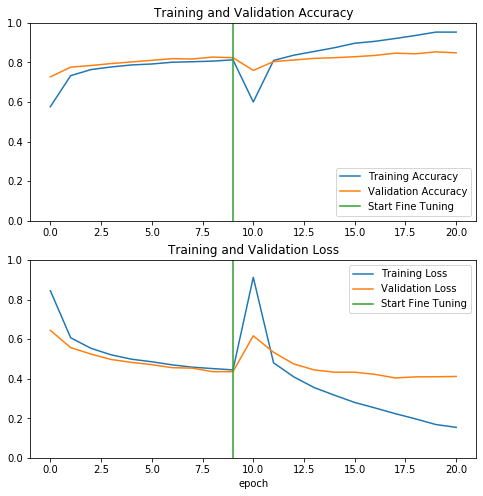

In [61]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

# Function with Frozen Layers

Results improved slightly when unfreezing the top layers. To see if changing parameters improves the model, I created the following function leveraging the model with the frozen layers

In [62]:
def image_processing(batch, width, height, initial_epochs_given = 10, metric = 'accuracy'):
    
    IMG_WIDTH = width
    IMG_HEIGHT = height
    batch_size = batch

    data_dir_train = pathlib.Path('./images/train/')
    data_dir_val = pathlib.Path('./images/validation/')
    data_dir_test = pathlib.Path('./images/test/')

    list_train = tf.data.Dataset.list_files(str(data_dir_train/'*/*'))
    list_val = tf.data.Dataset.list_files(str(data_dir_val/'*/*'))
    list_test = tf.data.Dataset.list_files(str(data_dir_test/'*/*'))

    labeled_train = list_train.map(process_path, num_parallel_calls=AUTOTUNE)
    labeled_test = list_test.map(process_path, num_parallel_calls=AUTOTUNE)
    labeled_val = list_val.map(process_path, num_parallel_calls=AUTOTUNE)

    train_ds = prepare_for_training(labeled_train)
    val_ds = prepare_for_training(labeled_val)
    test_ds = prepare_for_training(labeled_test)

    IMG_SHAPE = (IMG_WIDTH, IMG_HEIGHT, 3)

    # Create the base model from the pre-trained model MobileNet V2
    base_model = tf.keras.applications.MobileNetV2(input_shape=IMG_SHAPE,
                                                   include_top=False,
                                                   weights='imagenet')

    base_model.trainable = False
    
    for image_batchs, label_batch in train_ds.take(1):
        pass
    
    feature_batch = base_model(image_batchs)

    # Classification head
    global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
    feature_batch_average = global_average_layer(feature_batch)
    print(feature_batch_average.shape)

    # single prediction per image 
    prediction_layer = tf.keras.layers.Dense(3)
    prediction_batch = prediction_layer(feature_batch_average)
    print(prediction_batch.shape)

    model = tf.keras.Sequential([
      base_model,
      global_average_layer,
      prediction_layer
    ])

    base_learning_rate = 0.0001
    model.compile(optimizer=tf.keras.optimizers.Adam(lr=base_learning_rate),
                  loss=tf.keras.losses.CategoricalCrossentropy(from_logits=True),
                  metrics=[metric])

    initial_epochs = initial_epochs_given

    image_count = len(glob.glob('images/train/*/*.jpg'))
    image_count_v = len(glob.glob('images/validation/*/*.jpg'))

    step = np.ceil(image_count/batch_size)
    v_step = np.ceil(image_count_v/batch_size)

    history_tf = model.fit(train_ds,
                           epochs=initial_epochs,
                           steps_per_epoch = step,
                           validation_data=val_ds,
                           validation_steps = v_step
                          )
    
    model.save(f'model_{batch}_{width}_{initial_epochs_given}_{validation_steps_given}_{metric}')
    return history_tf

In [63]:
IMG_WIDTH = 160
IMG_HEIGHT = 160
m = image_processing(batch = 32, width = 160, height = 160, initial_epochs_given = 15)

(32, 1280)
(32, 3)
Epoch 1/15
148/148 [==============================] - 114s 771ms/step - loss: 0.9161 - accuracy: 0.5441 - val_loss: 0.6798 - val_accuracy: 0.6957
Epoch 2/15
148/148 [==============================] - 103s 696ms/step - loss: 0.6413 - accuracy: 0.7232 - val_loss: 0.6019 - val_accuracy: 0.7632
Epoch 3/15
148/148 [==============================] - 103s 695ms/step - loss: 0.5791 - accuracy: 0.7574 - val_loss: 0.5602 - val_accuracy: 0.7648
Epoch 4/15
148/148 [==============================] - 103s 696ms/step - loss: 0.5482 - accuracy: 0.7745 - val_loss: 0.5284 - val_accuracy: 0.7829
Epoch 5/15
148/148 [==============================] - 101s 682ms/step - loss: 0.5192 - accuracy: 0.7897 - val_loss: 0.5146 - val_accuracy: 0.7944
Epoch 6/15
148/148 [==============================] - 102s 692ms/step - loss: 0.5055 - accuracy: 0.7937 - val_loss: 0.4945 - val_accuracy: 0.7961
Epoch 7/15
148/148 [==============================] - 102s 689ms/step - loss: 0.4852 - accuracy: 0.8015 -

In [65]:
IMG_WIDTH = 224
IMG_HEIGHT = 224
m = image_processing(batch = 32, width = 224, height = 224, initial_epochs_given = 15)

(32, 1280)
(32, 3)
Epoch 1/15
148/148 [==============================] - 209s 1s/step - loss: 0.7367 - accuracy: 0.6417 - val_loss: 0.6493 - val_accuracy: 0.7122
Epoch 2/15
148/148 [==============================] - 235s 2s/step - loss: 0.5826 - accuracy: 0.7456 - val_loss: 0.5695 - val_accuracy: 0.7566
Epoch 3/15
148/148 [==============================] - 253s 2s/step - loss: 0.5379 - accuracy: 0.7686 - val_loss: 0.5439 - val_accuracy: 0.7780
Epoch 4/15
148/148 [==============================] - 282s 2s/step - loss: 0.5097 - accuracy: 0.7819 - val_loss: 0.5164 - val_accuracy: 0.7895
Epoch 5/15
148/148 [==============================] - 283s 2s/step - loss: 0.4947 - accuracy: 0.7834 - val_loss: 0.5007 - val_accuracy: 0.7993
Epoch 6/15
148/148 [==============================] - 268s 2s/step - loss: 0.4755 - accuracy: 0.7927 - val_loss: 0.4978 - val_accuracy: 0.7993
Epoch 7/15
148/148 [==============================] - 193s 1s/step - loss: 0.4674 - accuracy: 0.7979 - val_loss: 0.4744 - v

In [80]:
IMG_WIDTH = 416
IMG_HEIGHT = 416
m = image_processing(batch = 32, width = 416, height = 416, initial_epochs_given = 15)

(32, 1280)
(32, 3)
Epoch 1/15
148/148 [==============================] - 764s 5s/step - loss: 0.7963 - accuracy: 0.6360 - val_loss: 0.6890 - val_accuracy: 0.6990
Epoch 2/15
148/148 [==============================] - 722s 5s/step - loss: 0.6398 - accuracy: 0.7302 - val_loss: 0.6182 - val_accuracy: 0.7401
Epoch 3/15
148/148 [==============================] - 717s 5s/step - loss: 0.5933 - accuracy: 0.7608 - val_loss: 0.5797 - val_accuracy: 0.7599
Epoch 4/15
148/148 [==============================] - 719s 5s/step - loss: 0.5669 - accuracy: 0.7764 - val_loss: 0.5547 - val_accuracy: 0.7730
Epoch 5/15
148/148 [==============================] - 740s 5s/step - loss: 0.5448 - accuracy: 0.7851 - val_loss: 0.5398 - val_accuracy: 0.7747
Epoch 6/15
148/148 [==============================] - 737s 5s/step - loss: 0.5275 - accuracy: 0.7880 - val_loss: 0.5174 - val_accuracy: 0.7862
Epoch 7/15
148/148 [==============================] - 719s 5s/step - loss: 0.5148 - accuracy: 0.7929 - val_loss: 0.5112 - v

In [81]:
IMG_WIDTH = 224
IMG_HEIGHT = 224
m = image_processing(batch = 64, width = 224, height = 224, initial_epochs_given = 15)

(32, 1280)
(32, 3)
Epoch 1/15
74/74 [==============================] - 107s 1s/step - loss: 0.7315 - accuracy: 0.6461 - val_loss: 0.6649 - val_accuracy: 0.7219
Epoch 2/15
74/74 [==============================] - 96s 1s/step - loss: 0.6330 - accuracy: 0.7158 - val_loss: 0.6261 - val_accuracy: 0.7094
Epoch 3/15
74/74 [==============================] - 97s 1s/step - loss: 0.5872 - accuracy: 0.7378 - val_loss: 0.5775 - val_accuracy: 0.7563
Epoch 4/15
74/74 [==============================] - 94s 1s/step - loss: 0.5454 - accuracy: 0.7669 - val_loss: 0.5351 - val_accuracy: 0.7781
Epoch 5/15
74/74 [==============================] - 97s 1s/step - loss: 0.5408 - accuracy: 0.7652 - val_loss: 0.5168 - val_accuracy: 0.8094
Epoch 6/15
74/74 [==============================] - 103s 1s/step - loss: 0.5111 - accuracy: 0.7762 - val_loss: 0.5415 - val_accuracy: 0.7812
Epoch 7/15
74/74 [==============================] - 112s 2s/step - loss: 0.5046 - accuracy: 0.7736 - val_loss: 0.5046 - val_accuracy: 0.800

In [82]:
IMG_WIDTH = 224
IMG_HEIGHT = 224
m = image_processing(batch = 16, width = 224, height = 224, initial_epochs_given = 15)

(32, 1280)
(32, 3)
Epoch 1/15
295/295 [==============================] - 408s 1s/step - loss: 0.8134 - accuracy: 0.6284 - val_loss: 0.5934 - val_accuracy: 0.7331
Epoch 2/15
295/295 [==============================] - 464s 2s/step - loss: 0.5527 - accuracy: 0.7724 - val_loss: 0.5200 - val_accuracy: 0.7821
Epoch 3/15
295/295 [==============================] - 402s 1s/step - loss: 0.5004 - accuracy: 0.7893 - val_loss: 0.4861 - val_accuracy: 0.7905
Epoch 4/15
295/295 [==============================] - 396s 1s/step - loss: 0.4742 - accuracy: 0.7956 - val_loss: 0.4671 - val_accuracy: 0.8007
Epoch 5/15
295/295 [==============================] - 392s 1s/step - loss: 0.4550 - accuracy: 0.7996 - val_loss: 0.4521 - val_accuracy: 0.8091
Epoch 6/15
295/295 [==============================] - 393s 1s/step - loss: 0.4404 - accuracy: 0.8074 - val_loss: 0.4396 - val_accuracy: 0.8108
Epoch 7/15
295/295 [==============================] - 395s 1s/step - loss: 0.4316 - accuracy: 0.8105 - val_loss: 0.4368 - v

# Takeaways

Nothing will currently replace official molecular laboratory tests to identify Covid-19. There is work to be done to improve the image processing model. I look forward to accessing additional images and finding other pre-trained models that focus on X-rays. The data set is unbalanced with more pneumonia cases than healthy which likely led to more healthy images being classified as pneumonia. However, this is preferable over unhealthy patients being told their healthy. The more precautions people take, the better and hopefully sooner the pandemic is controlled.  